<a href="https://colab.research.google.com/github/nik-se0/MLDA/blob/main/Rain_in_Australia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [34]:
import numpy as np              # Одномерные и многомерные массивы (array)
import pandas as pd             # Таблицы и временные ряды (dataframe, series)
import matplotlib.pyplot as plt # Научная графика
import seaborn as sns           # Еще больше красивой графики для визуализации данных
import sklearn                  # Алгоритмы машинного обучения
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

# **Прогнозирование дождя на следующий день в Австралии**


##1. Описание задачи


Датасет weatherAUS.csv содержит данные ежедневных наблюдений за погодой в различных городах Австралии в период с 2007 по 2017 годы. Для каждого дня указаны различные метеорологические параметры, такие как температура, влажность, давление, скорость ветра, а также наличие осадков в течение дня.  Всего в датасете содержится около 145 тысяч наблюдений и 23 признака. Данные были собраны автоматическими метеостанциями по всей территории Австралии.

Целевой переменной является бинарный признак RainTomorrow, который указывает, будет ли дождь на следующий день или нет (*в колонке указывается "Да", если количество осадков в этот день составило 1 мм или более*)


Данный датасет содержит следующие признаки:
  - `Date` - дата наблюдения
  - `Location` - местоположение, город наблюдения
  - `MinTemp` - самая низкая температура дня (*градусы Цельсия*)
  - `MaxTemp` - самая высокая температура дня (*градусы Цельсия*)
  - `Rainfall	` - количество осадков за день (*единица измерения - мм*)
  - `Evaporation` - количество испарения воды, в течение 24 часов до 9 часов утра (*единица измерения - мм*)

  - `Sunshine` - количество часов яркого солнечного света в течение дня.
  - `WindGustDir` -	направление сильнейшего ветра за 24 часа до полуночи
  - `WindGustSpeed` -	 скорость самого сильного ветра за 24 часов до полуночи (*км / ч*)
  - `WindDir9am` - направление ветра в 9 часов утра
  - `WindDir3pm` - направление ветра в 3 часа дня
  - `WindSpeed9am` - средняя скорость ветра за десять минут, с 8:50 до 9:00 (*км / час*)
  - `WindSpeed3pm` - средняя скорость ветра за десять минут, с 14:50 до 15:00 (*км / час*)
  - `Humidity9am` - влажность в 9 часов утра (*%*)
  - `Humidity3pm` - влажность в 3 часа дня (*%*)
  - `Pressure9am` - атмосферное давление в 9 часов утра (*гпа*)
  - `Pressure3pm` - атмосферное давление в 3 часа дня (*гпа*)
  - `Cloud9am` - часть неба, закрытая облаками в 9 часов утра, принимает значения из промежутка от 0 до 8, где значение 0 указывает на полностью ясное небо, а значение 8 - полностью затянуто облаками
  - `Cloud3pm` - часть неба, закрытая облаками в 3 часа дня, принимает значения из промежутка от 0 до 8, где значение 0 указывает на полностью ясное небо, а значение 8 - полностью затянуто облаками
  - `Temp9am` -  температура в 9 часов утра (*в градусах Цельсия*)
  - `Temp3pm` - температура в 3 часа дня (*в градусах Цельсия*)
  - `RainToday` -	 идет ли дождь сегодня (*да/нет*)
  - `RainTomorrow` - будет ли дождь завтра (*да/нет*)



##2. Чтение данных

Загрузка данных из интернета:


In [35]:
url = "https://raw.githubusercontent.com/nik-se0/MLDA/main/weatherAUS.csv"
data_raw = pd.read_csv(url)
data_raw.shape

(145460, 23)

В текущем наборе данных содержится информация о 145460 наблюдениях, разделённая на  23 признака. Ознакомимся с информацией, хранящейся в нем

In [36]:
data_raw

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [37]:
data_raw.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

Подробная информация о столбцах набора данных

In [38]:
data_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

По полученному описанию можно определить наличие пропущенных значений, а так же провести типизацию признаков:
* `RainToday`, `RainTomorrow` - являются категориальными, бинарными признаками.
* `WindGustDir`, `WindDir9am`, `WindDir3pm` - являются категориальными, номинальными признаками.
* `Location` - текстовой признак
* Остальные будут являться количественными (числовыми) признаками.

Однако все категориальные признаки являются по типу `'object'`, исправим это., заменив тип на специальный, предназначенный для хранения категориальных значений: `'category'`

In [39]:
data_raw['WindGustDir'] = data_raw['WindGustDir'].astype('category')
data_raw['WindDir9am'] = data_raw['WindDir9am'].astype('category')
data_raw['WindDir3pm'] = data_raw['WindDir3pm'].astype('category')
data_raw['RainToday'] = data_raw['RainToday'].astype('category')
data_raw['RainTomorrow'] = data_raw['RainTomorrow'].astype('category')

In [40]:
data_raw['RainTomorrow'].dtype

CategoricalDtype(categories=['No', 'Yes'], ordered=False)

In [41]:
data_raw['WindGustDir'].dtype

CategoricalDtype(categories=['E', 'ENE', 'ESE', 'N', 'NE', 'NNE', 'NNW', 'NW', 'S', 'SE',
                  'SSE', 'SSW', 'SW', 'W', 'WNW', 'WSW'],
, ordered=False)

##3. Визуализация данных, вычисление основных характеристик


Выведем описательную статистику по нашему датасету: математическое описание для каждого признака
Сначала рассмотрим категориальные признаки

In [42]:
data_raw.describe(include=['category'])

,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,135134,134894,141232,142199,142193
unique,16,16,16,2,2
top,W,N,SE,No,No
freq,9915,11758,10838,110319,110316


* count - количество значений для каждого признака (значения признака Gender отличаются от всех остальных, так как в нем есть пропущенные значения)
* unique - количество уникальных значений
* top - значения, встречающиеся чаще всего
* freq - частота значений top

Теперь посмотрим на данные о количественных признаках

In [43]:
data_raw.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
std,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000


* count — количество значений для каждого признака
* mean — среднее значение
* std — стандартное отклонение, значение которого показывает, на сколько в среднем отклоняются варианты от среднего значения
* min — минимальное значение
* 25% — значения, которые объект не превышает с вероятностью 25%
* 50% — медиана, то есть значения, которые объект не превышает с вероятностью 25%
* 75% — значения, которые объект не превышает с вероятностью 75%
* max — максимальное значение

Внимательно изучив таблицу можно решить, в каких признках желательно обработать выбросы.
Считаем необходимым рассмотреть такие признаки, как: Humidity9am, WindSpeed3pm, WindSpeed9am, WindGustSpeed, Evaporation, Rainfall, Pressure3pm, Pressure9am, так как их средние и медианные значения ушли далеко от половины максимального значения.

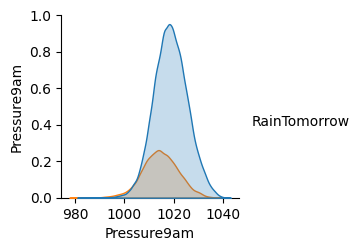

In [44]:
sns.pairplot(data_raw[["Pressure9am", "RainTomorrow"]], hue="RainTomorrow")

<Axes: ylabel='Pressure9am'>

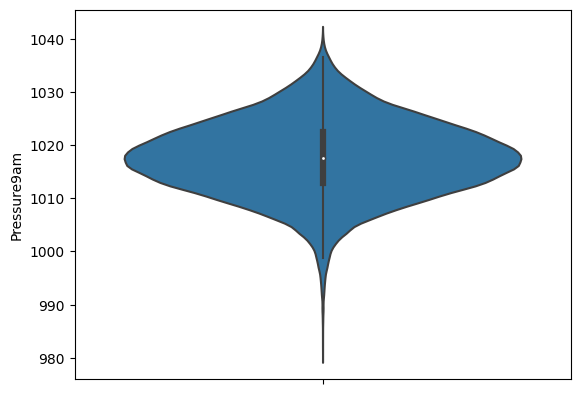

In [45]:
sns.violinplot(y="Pressure9am", data=data_raw)

График напоминает нечто похожее на нормальное распределение, выбросы не портят, гармонично дополняют картину на наш взгляд

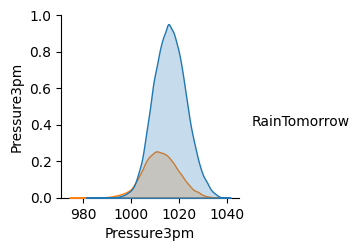

In [46]:
sns.pairplot(data_raw[["Pressure3pm", "RainTomorrow"]], hue="RainTomorrow")

<Axes: ylabel='Pressure3pm'>

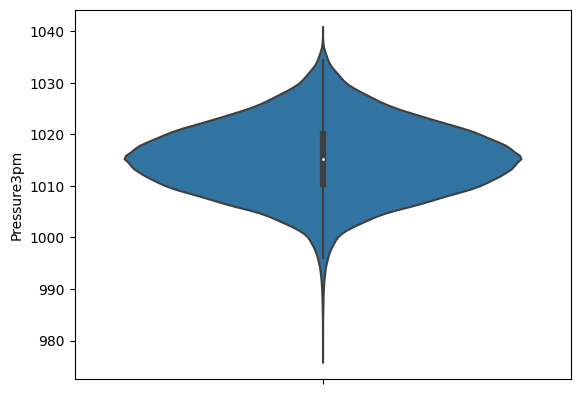

In [47]:
sns.violinplot(y="Pressure3pm", data=data_raw)

Такое же красивое распределение

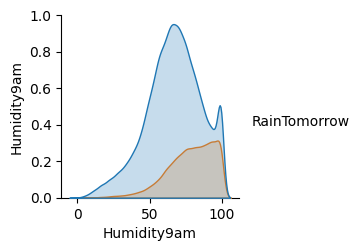

In [48]:
sns.pairplot(data_raw[["Humidity9am", "RainTomorrow"]], hue="RainTomorrow")

<Axes: ylabel='Humidity9am'>

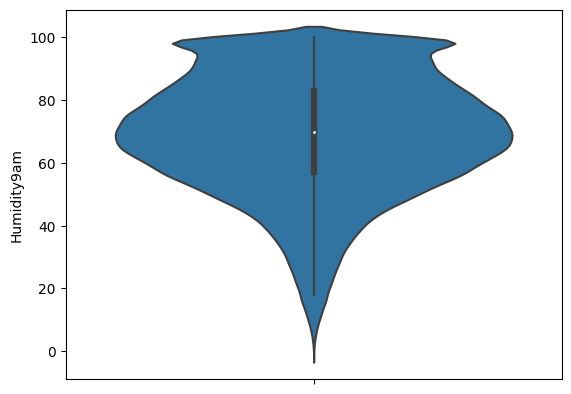

In [49]:
sns.violinplot(y="Humidity9am", data=data_raw)

Этот график уже  меньше напоминает нормальное распределение, однако выбросы все так же не портят картину на наш взгляд

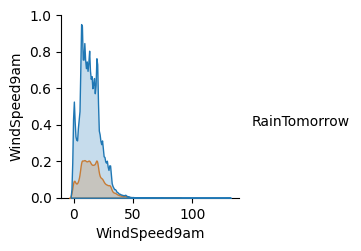

In [50]:
sns.pairplot(data_raw[["WindSpeed9am", "RainTomorrow"]], hue="RainTomorrow")

А вот тут явно есть выбросы, которые сильно раситягивают график. Рассмотрим их подробнее и избавимся от них

<Axes: ylabel='WindSpeed9am'>

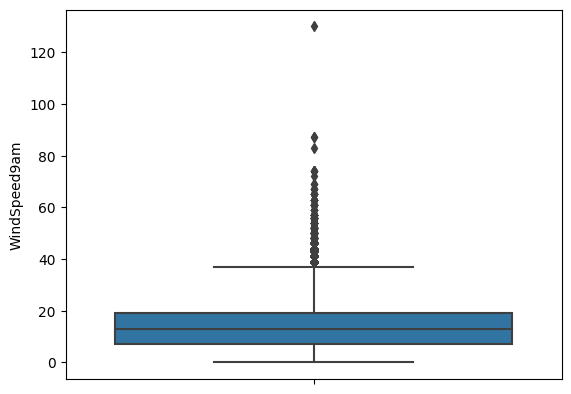

In [51]:
sns.boxplot(y="WindSpeed9am", data=data_raw)

<Axes: ylabel='WindSpeed9am'>

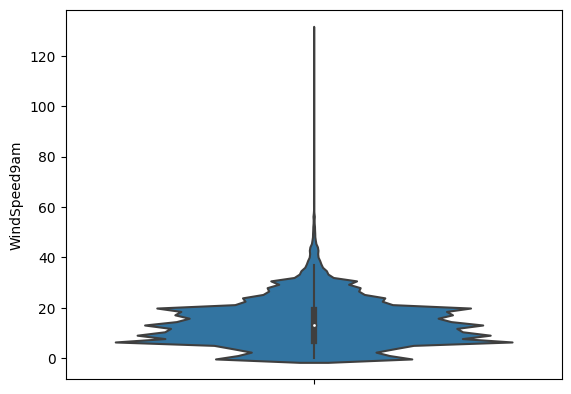

In [52]:
sns.violinplot(y="WindSpeed9am", data=data_raw)

In [53]:
data_raw['WindSpeed9am'].quantile(0.9995)

56.0

In [54]:
rows_to_drop = data_raw[data_raw['WindSpeed9am'] > data_raw['WindSpeed9am'].quantile(0.9995)].index
len(rows_to_drop)
data_raw = data_raw.drop(rows_to_drop)

<Axes: ylabel='WindSpeed9am'>

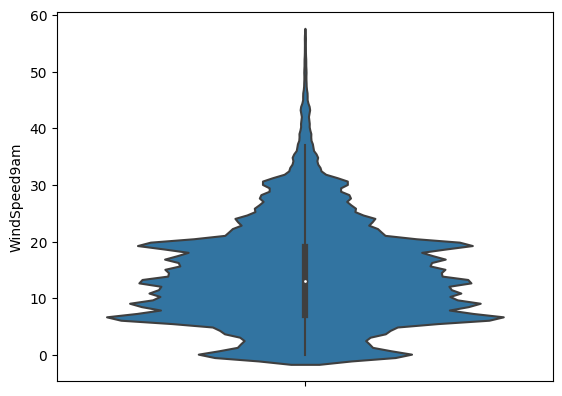

In [55]:
sns.violinplot(y="WindSpeed9am", data=data_raw)

Теперь картина стала намного лучше.

Продолжим анализ для оставшихся параметров

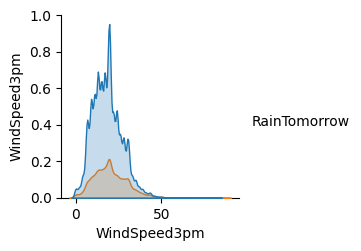

In [56]:
sns.pairplot(data_raw[["WindSpeed3pm", "RainTomorrow"]], hue="RainTomorrow")

Ситуация аналогична предыдущей, избавимся от выбросов

<Axes: ylabel='WindSpeed3pm'>

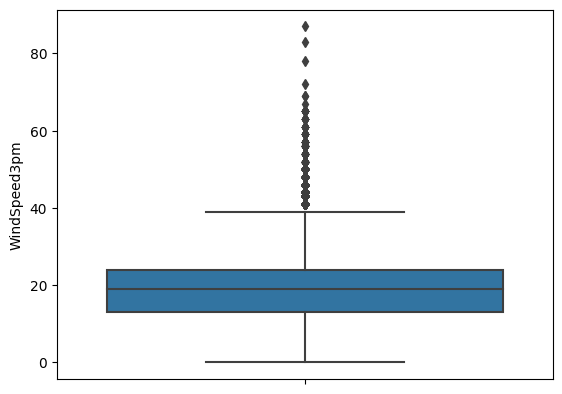

In [57]:
sns.boxplot(y="WindSpeed3pm", data=data_raw)

<Axes: ylabel='WindSpeed3pm'>

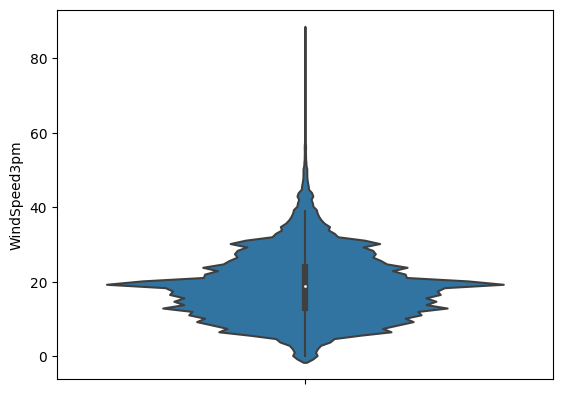

In [58]:
sns.violinplot(y="WindSpeed3pm", data=data_raw)

In [59]:
data_raw['WindSpeed3pm'].quantile(0.9993)

56.0

In [60]:
rows_to_drop = data_raw[data_raw['WindSpeed3pm'] > data_raw['WindSpeed3pm'].quantile(0.9993)].index
len(rows_to_drop)
data_raw = data_raw.drop(rows_to_drop)

<Axes: ylabel='WindSpeed3pm'>

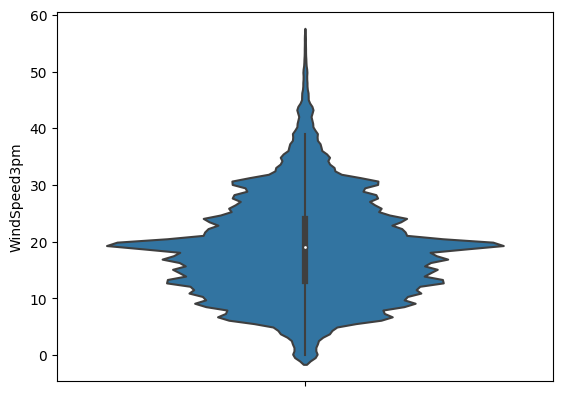

In [61]:
sns.violinplot(y="WindSpeed3pm", data=data_raw)

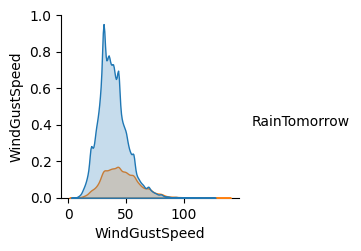

In [62]:
sns.pairplot(data_raw[["WindGustSpeed", "RainTomorrow"]], hue="RainTomorrow")

<Axes: ylabel='WindGustSpeed'>

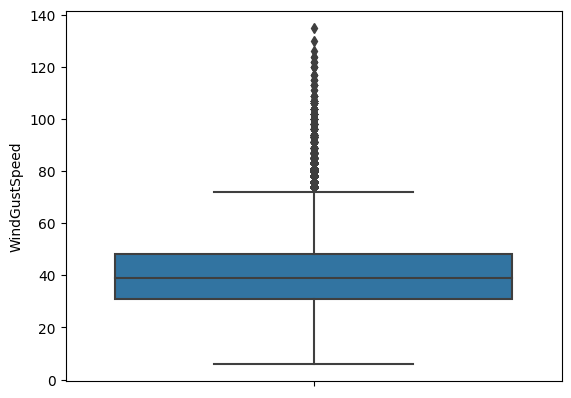

In [63]:
sns.boxplot(y="WindGustSpeed", data=data_raw)

<Axes: ylabel='WindGustSpeed'>

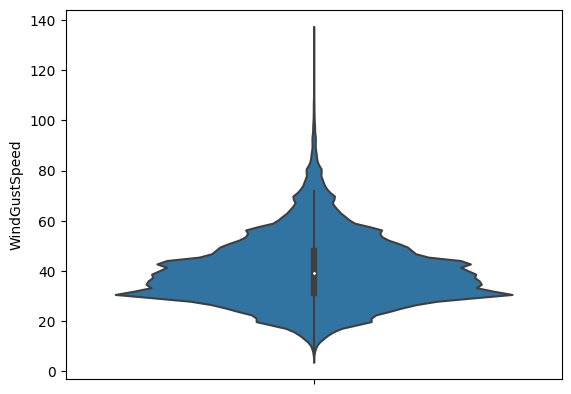

In [64]:
sns.violinplot(y="WindGustSpeed", data=data_raw)

In [65]:
rows_to_drop = data_raw[data_raw['WindGustSpeed'] > data_raw['WindGustSpeed'].quantile(0.9993)].index
len(rows_to_drop)
data_raw = data_raw.drop(rows_to_drop)

<Axes: ylabel='WindGustSpeed'>

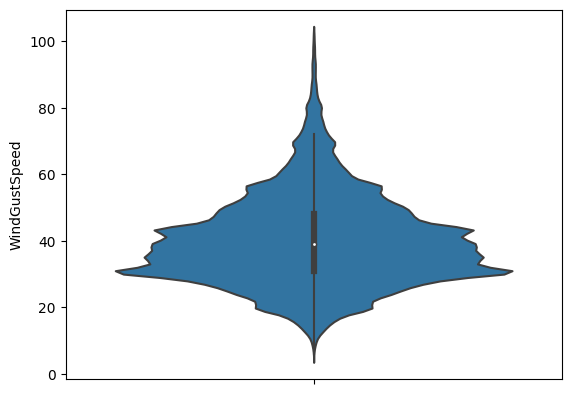

In [66]:
sns.violinplot(y="WindGustSpeed", data=data_raw)

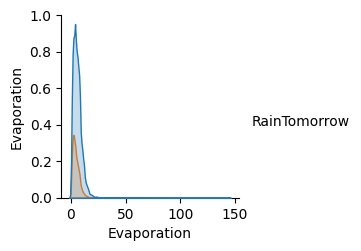

In [67]:
sns.pairplot(data_raw[["Evaporation", "RainTomorrow"]], hue="RainTomorrow")

<Axes: ylabel='Evaporation'>

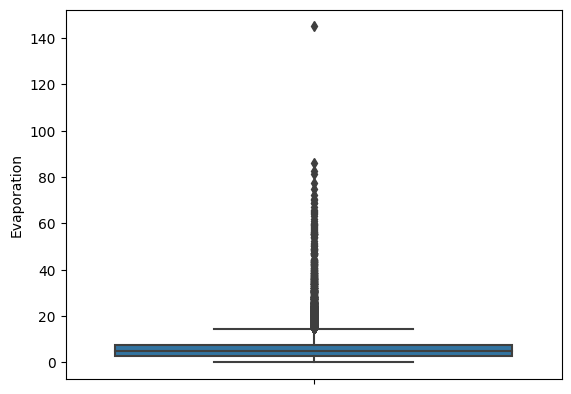

In [68]:
sns.boxplot(y="Evaporation", data=data_raw)

<Axes: ylabel='Evaporation'>

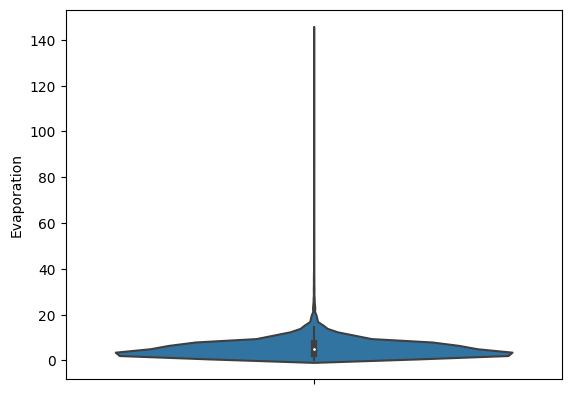

In [69]:
sns.violinplot(y="Evaporation", data=data_raw)

In [70]:
data_raw['Evaporation'].quantile(0.9965)

26.019900000002234

In [71]:
rows_to_drop = data_raw[data_raw['Evaporation'] > data_raw['Evaporation'].quantile(0.9965)].index
len(rows_to_drop)
data_raw = data_raw.drop(rows_to_drop)

<Axes: ylabel='Evaporation'>

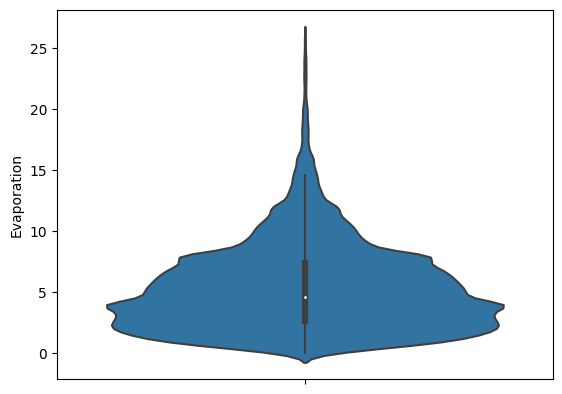

In [72]:
sns.violinplot(y="Evaporation", data=data_raw)

Интересно посмотреть, сколько раз номинальные переменные принимают то или иное значение

In [73]:
data_raw['WindGustDir'].value_counts()

W      9873
SE     9387
N      9253
SSE    9175
E      9160
S      9115
WSW    9041
SW     8947
SSW    8710
WNW    8215
NW     8087
ENE    8078
ESE    7350
NE     7110
NNW    6606
NNE    6530
Name: WindGustDir, dtype: int64

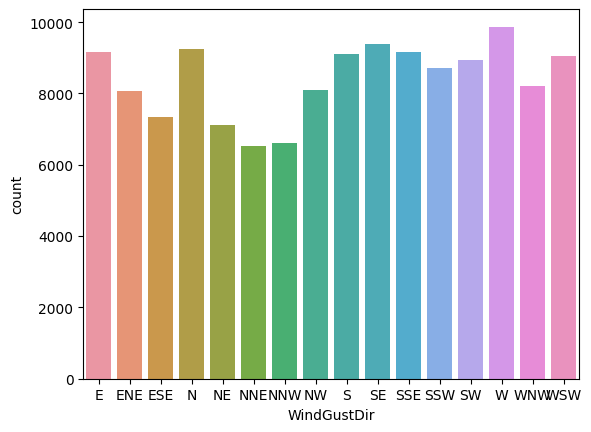

In [74]:
sns.countplot(x='WindGustDir', data=data_raw)
pass

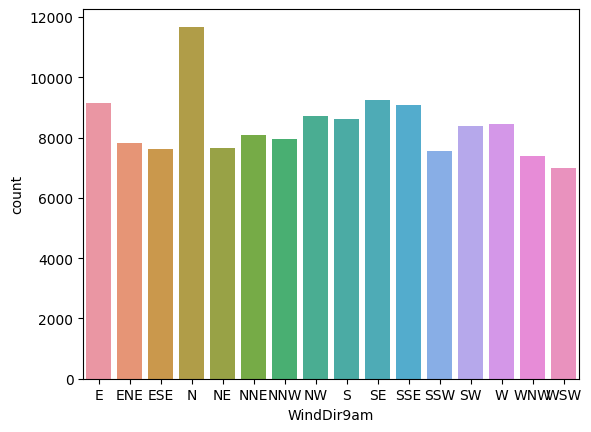

In [75]:
sns.countplot(x='WindDir9am', data=data_raw)
pass

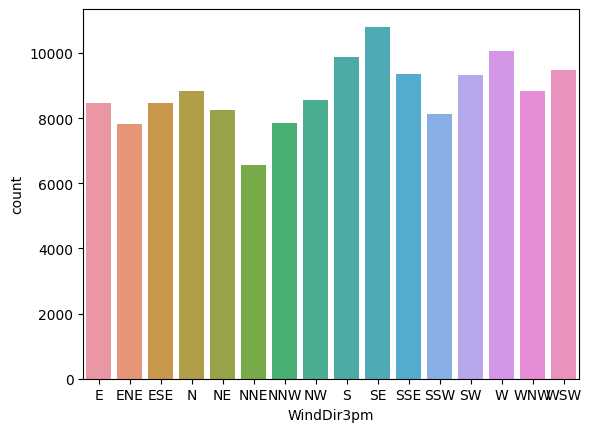

In [76]:
sns.countplot(x='WindDir3pm', data=data_raw)
pass

Аналогичным образом посмотрим, сколько раз бинарные признаки принимают свои значение

In [ ]:
data_raw['RainToday'].value_counts()

No     109948
Yes     31729
Name: RainToday, dtype: int64

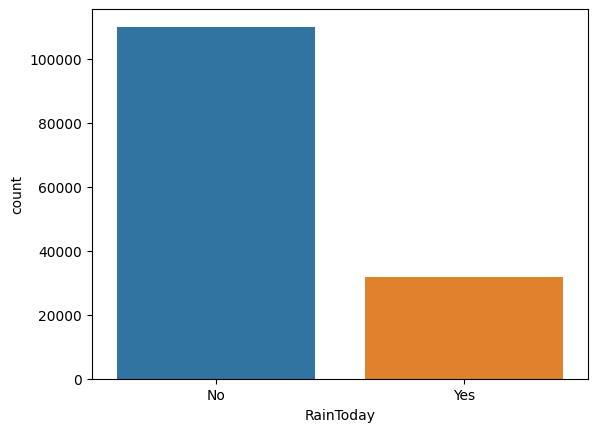

In [ ]:
sns.countplot(x='RainToday', data=data_raw)
pass

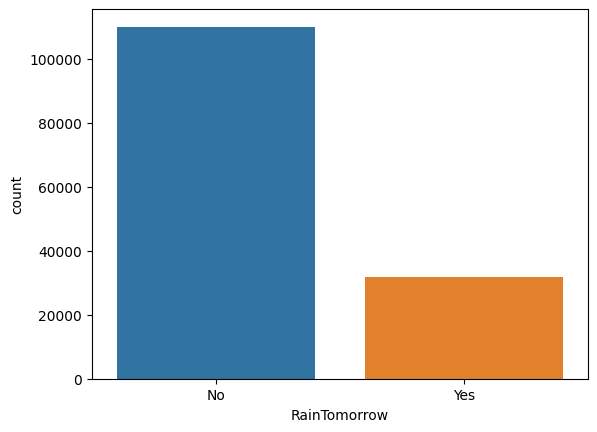

In [ ]:
sns.countplot(x='RainTomorrow', data=data_raw)
pass

Видим что данные не сбалансированные.
Можем посмотреть на соотношение классов более подробно

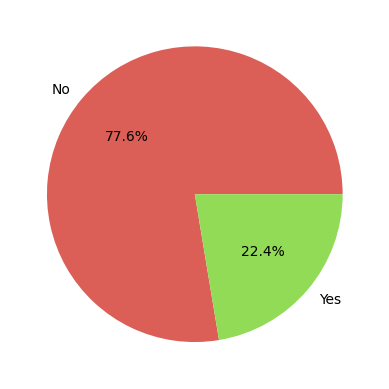

In [ ]:
plt.pie(data_raw['RainTomorrow'].value_counts(), labels = ["No", "Yes"], colors = sns.color_palette("hls",4), autopct = '%1.1f%%')
pass

Построение диаграммы рассеивания для признаков.

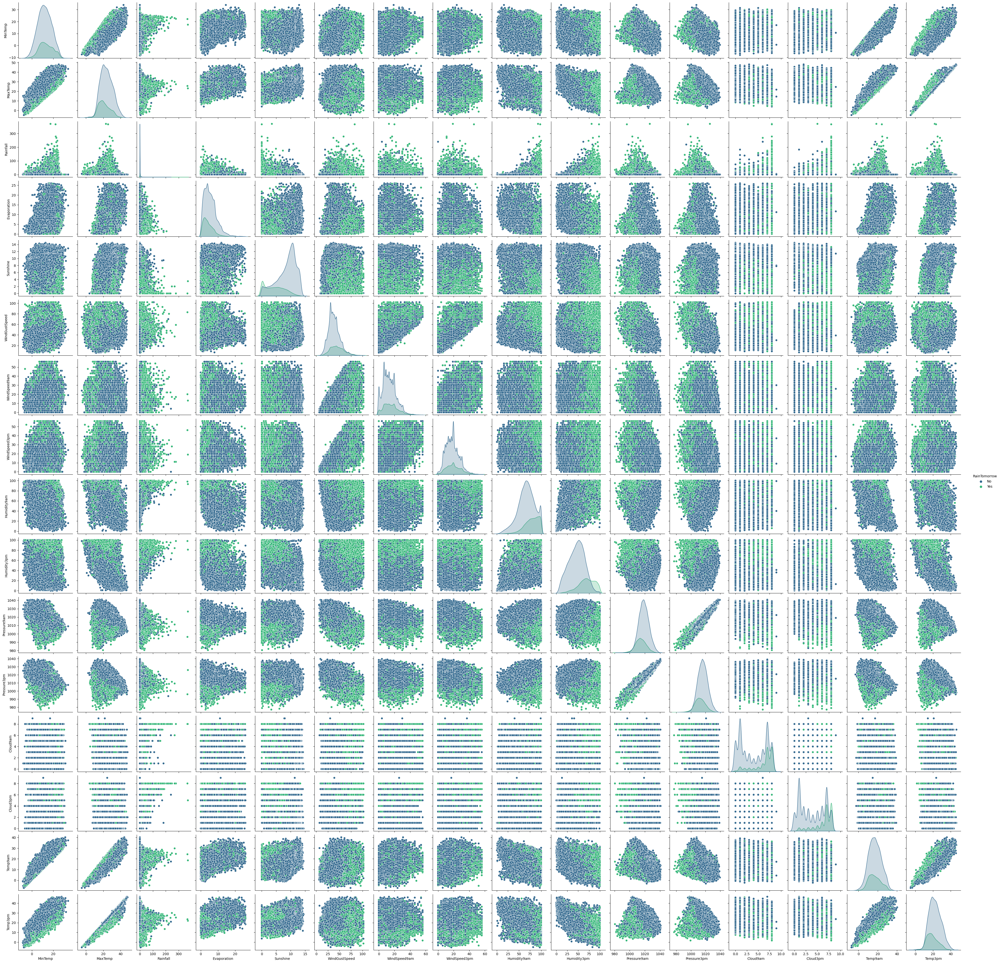

In [ ]:
sns.pairplot(data_raw, hue="RainTomorrow", palette="viridis")
pass

Выведем матрицу корреляции наших численных признаков:

In [ ]:
corr_mat = data_raw.corr(numeric_only=True)
corr_mat

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
MinTemp,1.000000,0.736282,0.104172,0.522646,0.071849,0.179228,0.176524,0.177627,-0.231884,0.007948,-0.451906,-0.462128,0.079858,0.021823,0.901819,0.708645
MaxTemp,0.736282,1.000000,-0.075179,0.651887,0.469904,0.069259,0.015588,0.052938,-0.503147,-0.507599,-0.333121,-0.428095,-0.288408,-0.277907,0.887023,0.984525
Rainfall,0.104172,-0.075179,1.000000,-0.081570,-0.227087,0.129855,0.081965,0.053259,0.224866,0.255576,-0.168178,-0.126187,0.198631,0.172255,0.010967,-0.079697
Evaporation,0.522646,0.651887,-0.081570,1.000000,0.379379,0.224158,0.209336,0.149423,-0.554284,-0.422449,-0.306019,-0.331003,-0.197719,-0.202334,0.608916,0.634632
Sunshine,0.071849,0.469904,-0.227087,0.379379,1.000000,-0.031146,0.008680,0.058428,-0.491134,-0.628934,0.040946,-0.020877,-0.674977,-0.704064,0.290785,0.490132
WindGustSpeed,0.179228,0.069259,0.129855,0.224158,-0.031146,1.000000,0.602326,0.682473,-0.216140,-0.027157,-0.456969,-0.411689,0.070871,0.107664,0.152070,0.034695
WindSpeed9am,0.176524,0.015588,0.081965,0.209336,0.008680,0.602326,1.000000,0.515201,-0.272628,-0.032312,-0.226049,-0.173015,0.024211,0.053572,0.130138,0.005798
WindSpeed3pm,0.177627,0.052938,0.053259,0.149423,0.058428,0.682473,0.515201,1.000000,-0.146280,0.015477,-0.293475,-0.252561,0.052057,0.023396,0.166036,0.030696
Humidity9am,-0.231884,-0.503147,0.224866,-0.554284,-0.491134,-0.216140,-0.272628,-0.146280,1.000000,0.666096,0.138139,0.185500,0.452088,0.357784,-0.470527,-0.497451
Humidity3pm,0.007948,-0.507599,0.255576,-0.422449,-0.628934,-0.027157,-0.032312,0.015477,0.666096,1.000000,-0.028561,0.050798,0.516606,0.523238,-0.219318,-0.556671


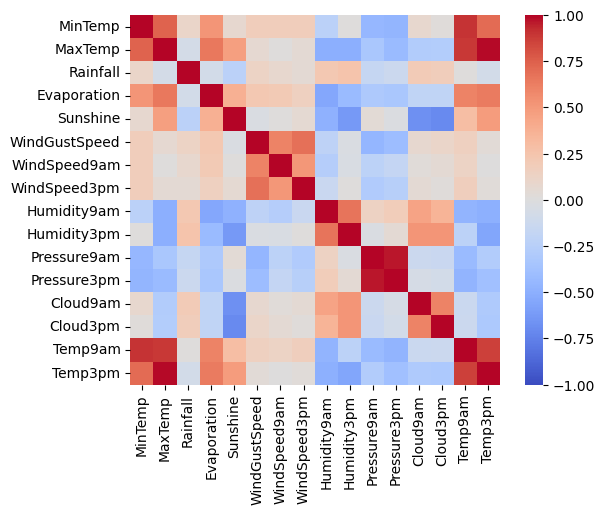

In [ ]:
sns.heatmap(corr_mat, square=True, vmin=-1, vmax=1, cmap='coolwarm')
pass

Поличим список признаков в которых наблюдается корелляция

In [ ]:
import numpy as np
corr_mat.where(np.triu(corr_mat > 0.5, k=1)).stack()

MinTemp        MaxTemp         0.736282
               Evaporation     0.522646
               Temp9am         0.901819
               Temp3pm         0.708645
MaxTemp        Evaporation     0.651887
               Temp9am         0.887023
               Temp3pm         0.984525
Evaporation    Temp9am         0.608916
               Temp3pm         0.634632
WindGustSpeed  WindSpeed9am    0.602326
               WindSpeed3pm    0.682473
WindSpeed9am   WindSpeed3pm    0.515201
Humidity9am    Humidity3pm     0.666096
Humidity3pm    Cloud9am        0.516606
               Cloud3pm        0.523238
Pressure9am    Pressure3pm     0.961420
Cloud9am       Cloud3pm        0.603239
Temp9am        Temp3pm         0.860427
dtype: float64

Исходя из этих данных заметна высокая, очевидная корреляция:
* между MinTemp, MaxTemp, Temp9am, Temp3pm - признаки температуры
* между Evaporation и MinTemp, MaxTemp, Temp9am, Temp3pm - признаки температуры и испарения
* между WindGustSpeed, WindSpeed9am, WindSpeed3pm - признаки скорости ветра
* между Humidity9am, Humidity3pm - признаки влажности
* между Cloud9am, Cloud3pm - признаки облачности

Более интересеные корреляции:
* между Sunshine, Temp3pm - признаки солнечности и температуры
* между Humidity3pm, Cloud9am, Cloud3pm - признаки влажности и облачности

In [ ]:
import numpy as np
corr_mat.where(np.triu(corr_mat < -0.5, k=1)).stack()

MaxTemp      Humidity9am   -0.503147
             Humidity3pm   -0.507599
Evaporation  Humidity9am   -0.554284
Sunshine     Humidity3pm   -0.628934
             Cloud9am      -0.674977
             Cloud3pm      -0.704064
Humidity3pm  Temp3pm       -0.556671
dtype: float64

Так же заметная обратная корреляции:
* между MaxTemp, Humidity9am, Humidity3pm - признаки температуры и влажности
* между Sunshine, Cloud9am, Cloud3pm - признаки солнечности и облачности

Выведем графики, нескольких интересующих нас пар:

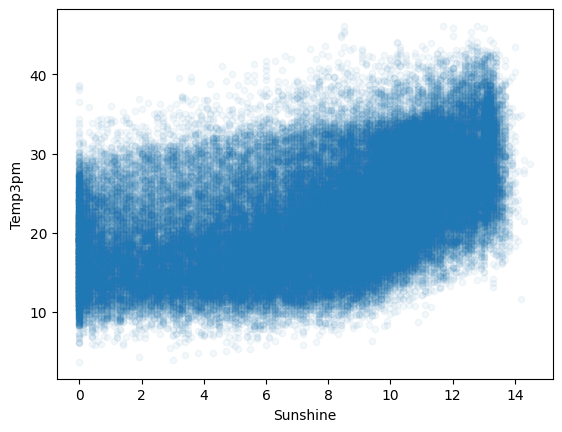

In [ ]:
data_raw.plot(kind = 'scatter', x = 'Sunshine', y = 'Temp3pm', alpha=.05)
pass

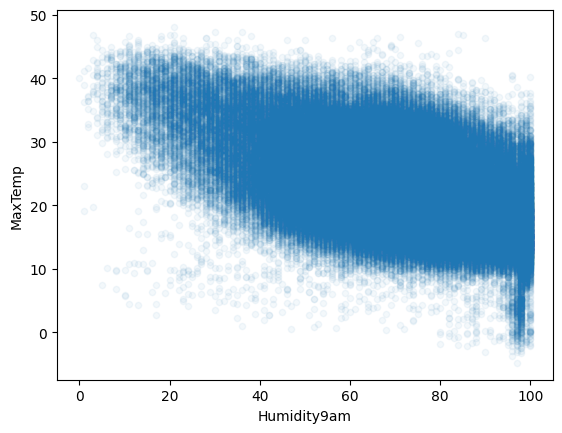

In [ ]:
data_raw.plot(kind = 'scatter', x = 'Humidity9am', y = 'MaxTemp', alpha=.05)
pass

<ipython-input-454-9042fc1deb36>:1: FutureWarning: The default value of numeric_only in DataFrame.corrwith is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_raw.drop('Rainfall', axis=1).corrwith(data_raw['Rainfall']).plot(kind='bar', grid=True, figsize=(16, 5));


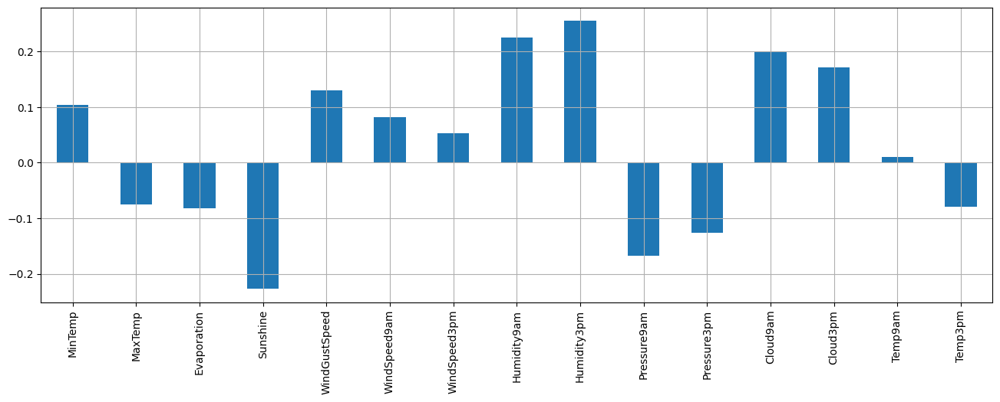

In [ ]:
data_raw.drop('Rainfall', axis=1).corrwith(data_raw['Rainfall']).plot(kind='bar', grid=True, figsize=(16, 5));
pass

Проверим взаимосвязь между численными признаками и дождем завтра, а именно как влияет на дождь:
* Humidity
* Pressure
* Temp

А так же проверим взаимосвязь между:
* Rain today ~ Rain tomorrow



Атмосферное давлениие

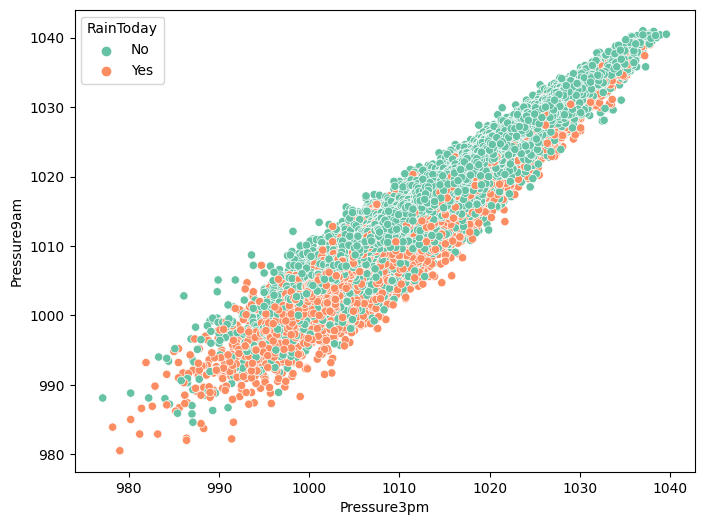

In [ ]:
plt.figure(figsize=(8,6))
sns.scatterplot(data=data_raw,x='Pressure3pm',y='Pressure9am',hue='RainToday', palette='Set2');

Низкое давление увеличивает вероятность дождя

Влажность

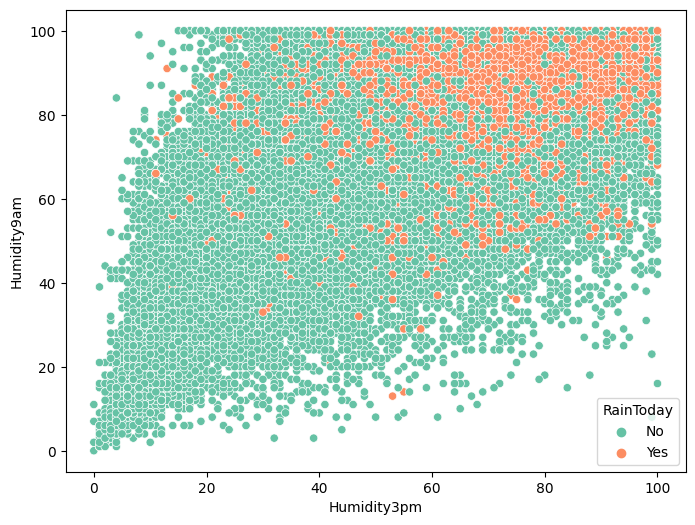

In [ ]:
plt.figure(figsize=(8,6))
sns.scatterplot(data=data_raw,x='Humidity3pm',y='Humidity9am',hue='RainToday', palette='Set2');
pass

Высокая влажность увеличивает вероятность дождя


Температура

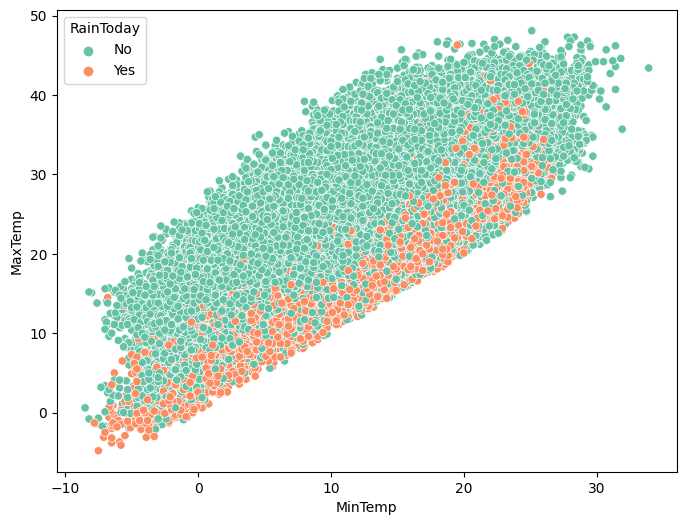

In [ ]:
plt.figure(figsize=(8,6))
sns.scatterplot(x='MinTemp', y='MaxTemp', data=data_raw, hue='RainToday', palette='Set2');

Вероятность дождя завтра больше, если максимальная и минимальная температуры дня примерно равны

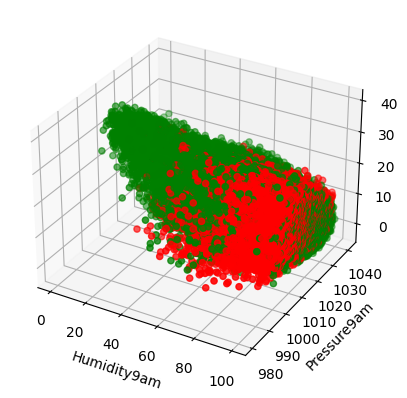

In [ ]:
# Создание трехмерного графика
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlabel('Humidity9am')
ax.set_ylabel('Pressure9am')
ax.set_zlabel('Temp9am')
c = ['r' if val == 'Yes' else 'g' for val in data_raw['RainToday']]
ax.scatter(data_raw['Humidity9am'], data_raw['Pressure9am'], data_raw['Temp9am'], c=c)

# Отображение графика
plt.show()

Получившийся график поддверждает наши утверждения: низкое давление и высокая влажность повышвют вероятность дождя

Дождь сегодня - дождь завтра

Посмотрим зависимость между тем, есль ли дождь сегодня, и будет ли дождь завтра

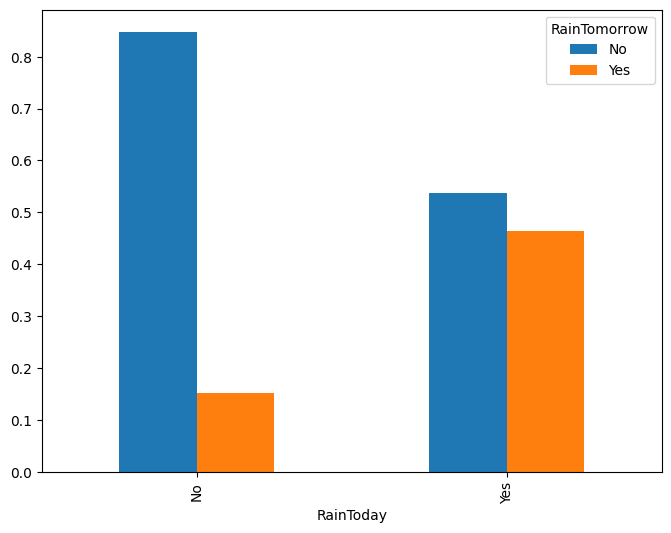

In [ ]:
ct = pd.crosstab(data_raw['RainToday'], columns=data_raw['RainTomorrow'], normalize='index')
ct.plot(kind="bar",figsize=(8,6));

Если сегодня нет дождя, завтра дождь пойдет с вероятностью = 15%
Если же дождь идет сегодня, вероятность дождя завтра = 47%

Рассмотрим больее подробно.

Если сегодня есть дождь до вероятность, что дождь будет завтра выглядит следующим образом

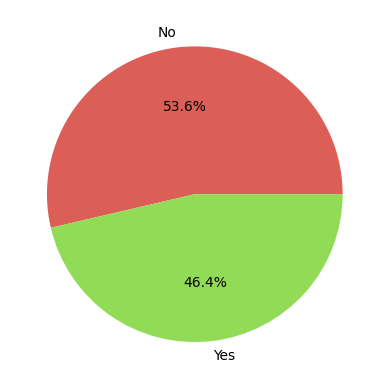

In [ ]:
plt.pie([ct['No']['Yes'], ct['Yes']['Yes']], labels=['No', 'Yes'], colors = sns.color_palette("hls",4), autopct='%1.1f%%')
pass

Аналогично, если сегодня есть дождь до вероятность, что дождь будет завтра будет такова

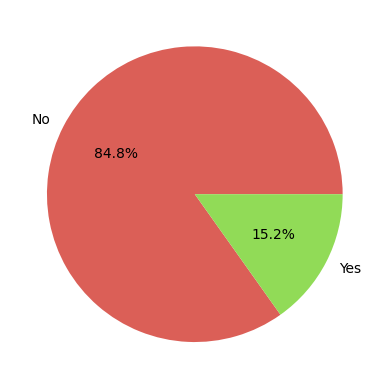

In [ ]:
plt.pie([ct['No']['No'], ct['Yes']['No']], labels=['No','Yes'], colors = sns.color_palette("hls",4), autopct='%1.1f%%')
pass

In [77]:
data_raw.drop('Date', axis=1, inplace=True)

## 4. Обработка пропущенных значений

Теперь проверим датасет на наличие пропущенных значений:

In [78]:
data_raw.isnull().sum()

Location             0
MinTemp           1481
MaxTemp           1258
Rainfall          3254
Evaporation      62676
Sunshine         69528
WindGustDir      10294
WindGustSpeed    10231
WindDir9am       10553
WindDir3pm        4218
WindSpeed9am      1763
WindSpeed3pm      3052
Humidity9am       2644
Humidity3pm       4486
Pressure9am      15041
Pressure3pm      15003
Cloud9am         55740
Cloud3pm         59196
Temp9am           1763
Temp3pm           3593
RainToday         3254
RainTomorrow      3252
dtype: int64

Мы видим столбцы с пропущенными значениями. Можно было бы просто на просто удалить строки с этими ячейками, но их достаточно много.

Поэтому заполним медианами пропущенные значения в столбцах, соответствующих числовым признакам.

In [79]:
data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)

<ipython-input-79-dcd17f8fdec0>:1: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_raw.fillna(data_raw.median(axis = 0), axis=0 , inplace=True)


Заполним наиболее частыми значения в столбцах (модой), соответствующих категориальным признакам

In [80]:
data_raw.WindDir9am.fillna(data_raw.WindDir9am.mode().iloc[0], inplace=True)
data_raw.WindDir3pm.fillna(data_raw.WindDir3pm.mode().iloc[0], inplace=True)
data_raw.WindGustDir.fillna(data_raw.WindGustDir.mode().iloc[0], inplace=True)
data_raw.RainTomorrow.fillna(data_raw.RainTomorrow.mode().iloc[0], inplace=True)
data_raw.RainToday.fillna(data_raw.RainToday.mode().iloc[0], inplace=True)

Проверим изменяния

In [81]:
data_raw.isna().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

##5. Бинаризация номинальных признаков


Алгоритмы из библиотеки scikit-learn (почти) не умеют работать напрямую с категориальными признаками. Поэтому их вначале надо закодировать с помощью числовых принаков.

Заменяем текстовые значения на числовые

In [82]:
data_raw['Location'] = LabelEncoder().fit_transform(data_raw['Location'])

In [83]:
data_raw.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2,13.4,22.9,0.6,4.6,8.4,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,No,No
1,2,7.4,25.1,0.0,4.6,8.4,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,No,No
2,2,12.9,25.7,0.0,4.6,8.4,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,No,No
3,2,9.2,28.0,0.0,4.6,8.4,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,No,No
4,2,17.5,32.3,1.0,4.6,8.4,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


Среди категориальных признаков есть бинарные и небинарные.

К бинарным относятся такие признаки, как RainToday и RainTomorrow. Заменим их значения на 0 и 1.

In [84]:
data_raw['RainToday'] = pd.factorize(data_raw['RainToday'])[0]
data_raw['RainTomorrow'] = pd.factorize(data_raw['RainTomorrow'])[0]

In [85]:
data_raw.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2,13.4,22.9,0.6,4.6,8.4,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,2,7.4,25.1,0.0,4.6,8.4,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,2,12.9,25.7,0.0,4.6,8.4,WSW,46.0,W,WSW,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,2,9.2,28.0,0.0,4.6,8.4,NE,24.0,SE,E,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,2,17.5,32.3,1.0,4.6,8.4,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0


Для категориальных (небинарных) признаках 'WindGustDir', 'WindDir9am', 'WindDir3pm' применим метод *бинаризации* (*one-hot encoding*)

In [86]:
enc = OneHotEncoder(drop='if_binary', sparse_output=False)
enc.fit(data_raw[['WindGustDir', 'WindDir9am', 'WindDir3pm']])
dummies = pd.DataFrame(enc.transform(data_raw[['WindGustDir', 'WindDir9am', 'WindDir3pm']]),
                       columns=enc.get_feature_names_out(), index=data_raw.index)

In [87]:
dummies.head()

,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,...,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Добавим эти dummy-столбцы к таблице и удалим исходные столбцы

In [88]:
data_raw = pd.concat((data_raw, dummies), axis=1).drop(['WindGustDir', 'WindDir9am', 'WindDir3pm'], axis=1)

In [89]:
data_raw.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,...,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
0,2,13.4,22.9,0.6,4.6,8.4,44.0,20.0,24.0,71.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,2,7.4,25.1,0.0,4.6,8.4,44.0,4.0,22.0,44.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,2,12.9,25.7,0.0,4.6,8.4,46.0,19.0,26.0,38.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,2,9.2,28.0,0.0,4.6,8.4,24.0,11.0,9.0,45.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2,17.5,32.3,1.0,4.6,8.4,41.0,7.0,20.0,82.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Перед применением алгоритмов машинного обучения количественные признаки полезно нормализовать.
Будем использовать стандартизацию - линейное преобразование, приводящее все значения к нулевому среднему и единичному стандартному отклонению

Выполним стандартизацию всех признаков.

In [90]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(data_raw)
data_raw = pd.DataFrame(scaler.transform(data_raw), columns=data_raw.columns, index=data_raw.index)

In [91]:
data_raw.describe()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,...,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
count,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,...,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05,1.449310e+05
mean,-9.413045e-17,2.321884e-16,-1.041710e-15,5.569385e-17,-4.706523e-17,-3.137682e-18,2.529756e-17,7.922646e-17,4.549639e-17,-5.334059e-17,...,-8.471741e-17,-5.334059e-17,-6.981342e-17,4.314312e-17,1.882609e-17,2.274819e-17,1.255073e-17,2.039493e-17,1.804167e-17,-5.490943e-17
std,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,...,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00
min,-1.672308e+00,-3.249143e+00,-3.956225e+00,-2.759223e-01,-1.837282e+00,-2.897399e+00,-2.619066e+00,-1.594663e+00,-2.160984e+00,-3.662974e+00,...,-2.393664e-01,-2.506948e-01,-2.704912e-01,-3.400764e-01,-2.628322e-01,-2.436067e-01,-2.622466e-01,-2.732572e-01,-2.548350e-01,-2.644935e-01
25%,-8.987521e-01,-7.039547e-01,-7.349634e-01,-2.759223e-01,-3.744123e-01,7.623944e-02,-6.857370e-01,-7.961568e-01,-6.521324e-01,-6.348878e-01,...,-2.393664e-01,-2.506948e-01,-2.704912e-01,-3.400764e-01,-2.628322e-01,-2.436067e-01,-2.622466e-01,-2.732572e-01,-2.548350e-01,-2.644935e-01
50%,1.545034e-02,-2.838006e-02,-8.505976e-02,-2.759223e-01,-1.549818e-01,1.487672e-01,-6.707177e-02,-1.117229e-01,4.426042e-02,5.572828e-02,...,-2.393664e-01,-2.506948e-01,-2.704912e-01,-3.400764e-01,-2.628322e-01,-2.436067e-01,-2.622466e-01,-2.732572e-01,-2.548350e-01,-2.644935e-01
75%,8.593295e-01,7.257498e-01,7.061273e-01,-2.037297e-01,6.444864e-02,2.575588e-01,4.742603e-01,5.727110e-01,6.245878e-01,7.463444e-01,...,-2.393664e-01,-2.506948e-01,-2.704912e-01,-3.400764e-01,-2.628322e-01,-2.436067e-01,-2.622466e-01,-2.732572e-01,-2.548350e-01,-2.644935e-01
max,1.703209e+00,3.412337e+00,3.517667e+00,4.436318e+01,7.671371e+00,2.360864e+00,4.804917e+00,4.793387e+00,4.338683e+00,1.649458e+00,...,4.177696e+00,3.988914e+00,3.696978e+00,2.940516e+00,3.804709e+00,4.104978e+00,3.813205e+00,3.659556e+00,3.924107e+00,3.780811e+00


##6. Разбить данные на обучающую и тестовую выборки


Для предсказания дождя завтра будем использовать все входные признаки

In [92]:
X = data_raw.drop(['RainTomorrow'], axis=1)
y = data_raw['RainTomorrow']

Разобьем данные на обучающую и тестовую выборки в пропорции 3:1 (75% - обучающая выборка, 25% - тестовая):

In [93]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size = 0.25, random_state = 42)

N_train, _ = X_train.shape
N_test,  _ = X_test.shape

N_train, N_test

(108698, 36233)

Интерпретируем все значения `y` как целые числа:

In [94]:
Y_test = Y_test.astype("int")
Y_train = Y_train.astype("int")

## 7. Используем классификатор ближайших соседей (kNN), вычислим ошибки на выборках.

Для начала запустим классификатор к-ближайших соседей с 3 соседями

In [95]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import mean_squared_error

model = KNeighborsClassifier(n_neighbors=3)
model.fit(X_train, Y_train)

Y_train_predict = model.predict(X_train)
Y_test_predict  = model.predict(X_test)


RMSE_train = mean_squared_error(Y_train, Y_train_predict)**.5
RMSE_test  = mean_squared_error(Y_test,  Y_test_predict)**.5

In [96]:
RMSE_train, RMSE_test

(0.3380531490068957, 0.44518478833348574)

## 8. Подберем оптимальное значение гиперпараметра (к-ва ближайших соседей)

Рассмотрим различное количество соседей. Наименьшая ошибка покажет нам наилуший выбор параметра k для метода.

In [ ]:
model = KNeighborsClassifier()
error_train = []
error_test = []
for i in range(1, 10):
    model = KNeighborsClassifier(n_neighbors=i)
    model.fit(X_train, Y_train)
    train_predict = model.predict(X_train)
    test_predict  = model.predict(X_test)
    error_train.append(np.mean(test_predict != Y_test ))
    error_test.append(np.mean(train_predict != Y_train))

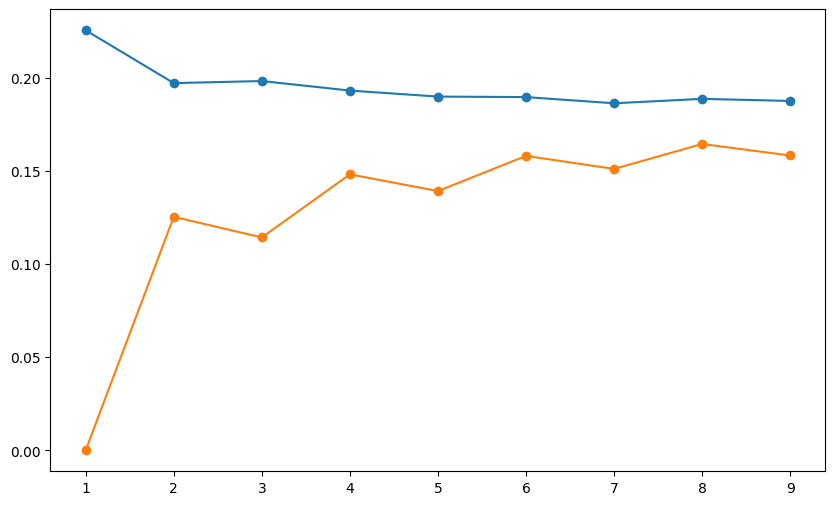

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(range(1,10),error_train,linestyle='solid', marker='o')
plt.plot(range(1,10),error_test,linestyle='solid', marker='o')

Лучший результат в 16% достигается при n=10

Во всех случаях ошибка на тестовой выборке оказывалась больше, чем на тренировочной, что может свидетельствовать о некотором переобучении модели.

Подводя итог, можно сделать вывод, что "предобработка" данных была выполнена успешно и задача классификации решена.

## 9. Борьба с несбалансированностью классов

Ранее мы выяснили что в классах присутствует сильная несбалансированность

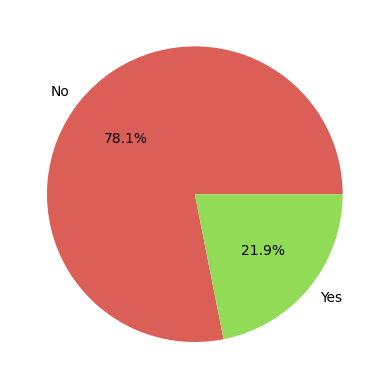

In [97]:
plt.pie(data_raw['RainTomorrow'].value_counts(), labels = ["No", "Yes"], colors = sns.color_palette("hls",4), autopct = '%1.1f%%')
pass

Интерпретируем все значения RainTomorrow как целые числа:

In [98]:
RainTomorrow2 = data_raw["RainTomorrow"].astype("int")
data_raw.drop('RainTomorrow', axis=1, inplace=True)
data_raw = pd.concat((data_raw, RainTomorrow2), axis=1)

Попробуем исправить ситуацию выкинув часть значений из класса "No"

In [99]:
class_0 = int((data_raw[data_raw["RainTomorrow"] == 0])["RainTomorrow"].value_counts())
class_1 = int((data_raw[data_raw["RainTomorrow"] == 1])["RainTomorrow"].value_counts())
class_0 - class_1

81509

In [100]:
data_balanced = data_raw.copy()
data_balanced = data_balanced.drop(data_balanced.loc[data_balanced["RainTomorrow"] == 0].sample(n=class_0 - class_1).index)

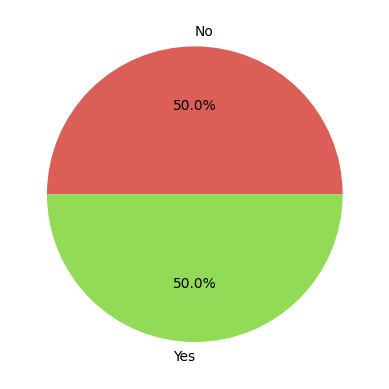

In [101]:
plt.pie(data_balanced['RainTomorrow'].value_counts(), labels = ["No", "Yes"], colors = sns.color_palette("hls",4), autopct = '%1.1f%%')
pass

Теперь мы уравняли колличество данных по классам, попробуем обучить на них классификатор


In [102]:
X = data_balanced.drop("RainTomorrow", axis=1)
Y = data_balanced["RainTomorrow"]

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.25, random_state = 42)

N_train, _ = X_train.shape
N_test,  _ = X_test.shape

N_train, N_test

(47566, 15856)

In [103]:
model = KNeighborsClassifier(n_neighbors=9)
model.fit(X_train, Y_train)
Y_train_prediction = model.predict(X_train)
Y_test_prediction = model.predict(X_test)

In [104]:
RMSE_train = mean_squared_error(Y_train, Y_train_prediction)**.5
RMSE_test  = mean_squared_error(Y_test,  Y_test_prediction)**.5
RMSE_train, RMSE_test

(0.4652721318395574, 0.5333835222769154)

Матрица для тестовых данных

In [106]:
from sklearn.metrics import classification_report
print(classification_report(Y_test, Y_test_prediction))

              precision    recall  f1-score   support

           0       0.70      0.76      0.73      7987
           1       0.73      0.67      0.70      7869

    accuracy                           0.72     15856
   macro avg       0.72      0.72      0.71     15856
weighted avg       0.72      0.72      0.71     15856



Таким образом после борьбы с несбалансированностью точность метода ближайших соседей ожидаемо упала. Однако класс 1 стал определяться намного лучше

# Общие выводы

В данной работе мы познакомились с датасетом  weatherAUS.csv. Выяснили некоторые подробности о взаимосвязи температурных, и иных показателей на наличиие/отсутвие дождя на завтра. Нашли и разрешили проблему с наличием пропущенных значений. Провели некоторую подготовку данных: векторизацию категориальных признаков и стандартизацию количественных. Для визуализации данных мы использовали библиотеку seaborn и построили диаграмму violinplot для всех параметров. В результате наша работа позволила успешно обучить модели для предсказания наличия/отсутствия дождя на завтра и получить хорошие метрики качества. Успешно обучили модели kNN, подобрали наиболее удачное количество соседей, немного поэкспериментировали. Также рассмотрели проблему несбалансированности данных.